# The PositionInterpolator

Here we cover the detail of the **PositionInterpolator**. This tool allows you to gather lots of information about what is occurring during an orbit or trigger.

## The Constructor
The constructor is build a **PositionInterpolator** from both a Trigdat file and a daily position history file. 

In [1]:
from gbmgeometry import PositionInterpolator
from gbmgeometry.utils.package_utils import get_path_of_data_file

trigdat_file = get_path_of_data_file('glg_trigdat_all_bn080916009_v02.fit')

pi = PositionInterpolator.from_trigdat(trigdat_file)

posthist_file = get_path_of_data_file('glg_poshist_all_151013_v00.fit')

pi = PositionInterpolator.from_poshist(posthist_file)

You can even build them from HdF5 file versions of the normal fits files. What? Yes we provide a converter for that as the HDF5 is much smaller and faster to load

In [2]:
from gbmgeometry import convert_poshist2hdf5, convert_trigdat2hdf5

convert_poshist2hdf5(posthist_file, 'my_posthist.h5')

convert_trigdat2hdf5(trigdat_file, 'my_trigdat.h5')

and to load them

In [3]:

trigdat_file = get_path_of_data_file('trigdat.h5')

pi = PositionInterpolator.from_trigdat_hdf5(trigdat_file)

posthist_file = get_path_of_data_file('posthist.h5')

pi = PositionInterpolator.from_poshist_hdf5(posthist_file)

## Plotting
We will do the fun stuff first. As the **PositionInterpolator** contains a lot of information about where Fermi is, we can use it to plot where the spacecraft is relative to Earth.



### Static

In [4]:
from gbmgeometry import plot_in_space

pi = PositionInterpolator.from_poshist_hdf5(posthist_file)

# get the min and max time store in the file
tmin, tmax = pi.minmax_time()

plot_in_space(pi, tmin)

Cool. But where are the detectors pointing?

In [5]:
plot_in_space(pi, tmin+1000, show_detector_pointing=True)

Where is the moon? Oh, I also miss the stars on the night sky.

In [6]:
plot_in_space(pi, tmin+1000, show_detector_pointing=True, show_moon=True, show_stars=True)

Yes, yes, you can also show the Sun... but it is not very useful at the moment.

### Animation

Let's go crazy and watch Fermi orbit

In [7]:
from gbmgeometry import animate_in_space

animate_in_space(pi, n_step=1000, show_stars=True)

Now with the detectors

In [8]:
animate_in_space(pi, n_step=1000, show_stars=True, show_detector_pointing=True)

We can add the Moon now, but let's get rid of the star and kick back the resolution so that it doesn't take so long to render. if you watch closely, you can see the Moon slowly orbit. Zoom in if you do not believe me.

In [9]:
animate_in_space(pi, n_step=500, show_detector_pointing=True, show_moon=True)

## Basic functions

We can check to see if Fermi is active at any time. For example, it is shut off during SAA passage.

In [10]:
pi.is_fermi_active(tmin)

True

<IPython.core.display.Javascript object>


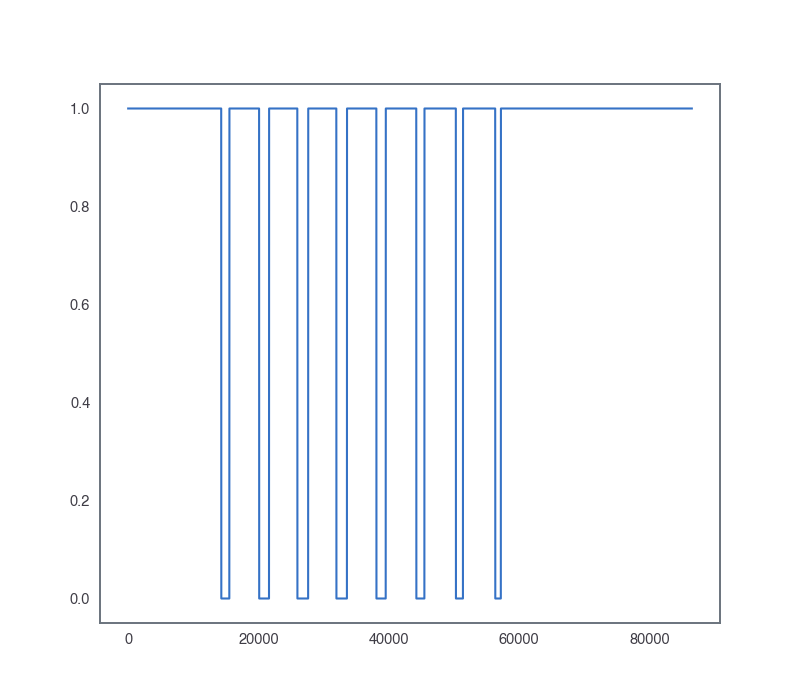

In [11]:
fig, ax = plt.subplots()

time = np.linspace(tmin, tmax, 5000)

ax.plot(time-tmin,pi.is_fermi_active(time) )